In [1]:
import os
import random
from pathlib import Path
import numpy as np
import pandas as pd
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = False
    torch.backends.cudnn.benchmark = True

seed_everything(42)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

Device: cuda


In [ ]:
# Tự động tìm folder chứa 'rain14000'
KAGGLE_INPUT = Path("/kaggle/input")
cands = [p for p in KAGGLE_INPUT.iterdir() if p.is_dir() and "rain14000" in p.name.lower()]

if len(cands) > 0:
    DATA_ROOT = cands[0]
else:
    DATA_ROOT = Path("/kaggle/input/rain14000") # Fallback

print("DATA_ROOT =", DATA_ROOT)

# Cấu hình đường dẫn
TRAIN_IN  = DATA_ROOT / "train" / "input"
TRAIN_GT  = DATA_ROOT / "train" / "output"
VAL_IN    = DATA_ROOT / "val" / "input"
VAL_GT    = DATA_ROOT / "val" / "output"
TEST_IN   = DATA_ROOT / "test" / "input"
TEST_GT   = DATA_ROOT / "test" / "output"

# Kiểm tra tồn tại
for p in [TRAIN_IN, TRAIN_GT, VAL_IN, TEST_IN]:
    print(f"{p} exists: {p.exists()}")

def list_images(folder: Path):
    exts = (".png", ".jpg", ".jpeg", ".bmp")
    if not folder.exists(): return []
    return sorted([x for x in folder.iterdir() if x.suffix.lower() in exts])

print(f"\n#Train: {len(list_images(TRAIN_IN))}")
print(f"#Val  : {len(list_images(VAL_IN))}")
print(f"#Test : {len(list_images(TEST_IN))}")

DATA_ROOT = /kaggle/input/rain14000
/kaggle/input/rain14000/train/input exists: True
/kaggle/input/rain14000/train/output exists: True
/kaggle/input/rain14000/val/input exists: True
/kaggle/input/rain14000/test/input exists: True

#Train: 10968
#Val  : 1371
#Test : 1372


In [3]:
def pil_to_tensor(img: Image.Image) -> torch.Tensor:
    arr = np.array(img).astype(np.float32) / 255.0
    if arr.ndim == 2:
        arr = np.stack([arr, arr, arr], axis=-1)
    if arr.shape[2] == 4:
        arr = arr[:, :, :3]
    t = torch.from_numpy(arr).permute(2, 0, 1).contiguous()
    return t

def random_crop_pair(x, y, patch=100):
    _, H, W = x.shape
    if H < patch or W < patch: return x, y
    top = random.randint(0, H - patch)
    left = random.randint(0, W - patch)
    return x[:, top:top+patch, left:left+patch], y[:, top:top+patch, left:left+patch]

def random_flip_pair(x, y):
    if random.random() < 0.5: # Horizontal
        x = torch.flip(x, dims=[2])
        y = torch.flip(y, dims=[2])
    if random.random() < 0.5: # Vertical
        x = torch.flip(x, dims=[1])
        y = torch.flip(y, dims=[1])
    return x, y

class PairedDerainDataset(Dataset):
    def __init__(self, input_dir: Path, gt_dir: Path, patch_size=None, augment=False):
        self.input_dir = input_dir
        self.gt_dir = gt_dir
        self.patch_size = patch_size
        self.augment = augment
        self.inputs = list_images(input_dir)
        self.gts = list_images(gt_dir)
        
        # Mapping file
        gt_map = {p.name: p for p in self.gts}
        self.pairs = []
        for inp in self.inputs:
            if inp.name in gt_map:
                self.pairs.append((inp, gt_map[inp.name]))
        if not self.pairs: self.pairs = list(zip(self.inputs, self.gts))

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        in_path, gt_path = self.pairs[idx]
        rainy = Image.open(in_path).convert("RGB")
        clean = Image.open(gt_path).convert("RGB")
        
        rainy_t = pil_to_tensor(rainy)
        clean_t = pil_to_tensor(clean)

        if self.patch_size:
            rainy_t, clean_t = random_crop_pair(rainy_t, clean_t, patch=self.patch_size)
        if self.augment:
            rainy_t, clean_t = random_flip_pair(rainy_t, clean_t)

        return rainy_t, clean_t, in_path.name

In [4]:
def _gaussian_kernel(window_size, sigma, channels, device):
    coords = torch.arange(window_size, dtype=torch.float32, device=device) - window_size // 2
    g = torch.exp(-(coords**2) / (2 * sigma**2))
    g = g / g.sum()
    kernel_2d = (g[:, None] * g[None, :]).unsqueeze(0).unsqueeze(0)
    kernel_2d = kernel_2d.repeat(channels, 1, 1, 1)
    return kernel_2d

def ssim_torch(x, y, window_size=11, sigma=1.5, data_range=1.0):
    N, C, H, W = x.shape
    device = x.device
    kernel = _gaussian_kernel(window_size, sigma, C, device)
    padding = window_size // 2
    mu_x = F.conv2d(x, kernel, padding=padding, groups=C)
    mu_y = F.conv2d(y, kernel, padding=padding, groups=C)
    mu_x2 = mu_x * mu_x
    mu_y2 = mu_y * mu_y
    mu_xy = mu_x * mu_y
    sigma_x2 = F.conv2d(x * x, kernel, padding=padding, groups=C) - mu_x2
    sigma_y2 = F.conv2d(y * y, kernel, padding=padding, groups=C) - mu_y2
    sigma_xy = F.conv2d(x * y, kernel, padding=padding, groups=C) - mu_xy
    C1 = (0.01 * data_range) ** 2
    C2 = (0.03 * data_range) ** 2
    ssim_map = ((2 * mu_xy + C1) * (2 * sigma_xy + C2)) / ((mu_x2 + mu_y2 + C1) * (sigma_x2 + sigma_y2 + C2) + 1e-12)
    return ssim_map.mean()

class SSIMLoss(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, pred, target):
        return -ssim_torch(pred, target)

def psnr_torch(pred, target, data_range=1.0):
    mse = torch.mean((pred - target) ** 2)
    if mse.item() == 0: return torch.tensor(99.0, device=pred.device)
    return 10.0 * torch.log10((data_range ** 2) / mse)

In [5]:
class PReNet(nn.Module):
    def __init__(self, recurrent_iter=6, use_GPU=True):
        super(PReNet, self).__init__()
        self.iteration = recurrent_iter
        self.use_GPU = use_GPU
        self.conv0 = nn.Sequential(nn.Conv2d(6, 32, 3, 1, 1), nn.ReLU())
        self.res_conv1 = nn.Sequential(nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU(), nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU())
        self.res_conv2 = nn.Sequential(nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU(), nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU())
        self.res_conv3 = nn.Sequential(nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU(), nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU())
        self.res_conv4 = nn.Sequential(nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU(), nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU())
        self.res_conv5 = nn.Sequential(nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU(), nn.Conv2d(32, 32, 3, 1, 1), nn.ReLU())
        self.conv_i = nn.Sequential(nn.Conv2d(32 + 32, 32, 3, 1, 1), nn.Sigmoid())
        self.conv_f = nn.Sequential(nn.Conv2d(32 + 32, 32, 3, 1, 1), nn.Sigmoid())
        self.conv_g = nn.Sequential(nn.Conv2d(32 + 32, 32, 3, 1, 1), nn.Tanh())
        self.conv_o = nn.Sequential(nn.Conv2d(32 + 32, 32, 3, 1, 1), nn.Sigmoid())
        self.conv = nn.Sequential(nn.Conv2d(32, 3, 3, 1, 1))

    def forward(self, input):
        batch_size, row, col = input.size(0), input.size(2), input.size(3)
        x = input
        h = torch.zeros(batch_size, 32, row, col, device=input.device)
        c = torch.zeros(batch_size, 32, row, col, device=input.device)
        x_list = []
        for _ in range(self.iteration):
            x = torch.cat((input, x), 1)
            x = self.conv0(x)
            x = torch.cat((x, h), 1)
            i = self.conv_i(x)
            f = self.conv_f(x)
            g = self.conv_g(x)
            o = self.conv_o(x)
            c = f * c + i * g
            h = o * torch.tanh(c)
            x = h
            resx = x
            x = F.relu(self.res_conv1(x) + resx)
            resx = x
            x = F.relu(self.res_conv2(x) + resx)
            resx = x
            x = F.relu(self.res_conv3(x) + resx)
            resx = x
            x = F.relu(self.res_conv4(x) + resx)
            resx = x
            x = F.relu(self.res_conv5(x) + resx)
            x = self.conv(x)
            x = x + input
            x_list.append(x)
        return x, x_list

In [ ]:
PATCH_SIZE = 100
BATCH_SIZE = 18
EPOCHS = 100
LR = 1e-3
MILESTONES = [30, 50, 80]
GAMMA = 0.2
T_STAGES = 6 

# --- SỬ DỤNG 4 WORKERS ---
NUM_WORKERS = 4 

train_ds = PairedDerainDataset(TRAIN_IN, TRAIN_GT, patch_size=PATCH_SIZE, augment=True)
val_ds   = PairedDerainDataset(VAL_IN, VAL_GT, patch_size=None, augment=False)
test_ds  = PairedDerainDataset(TEST_IN, TEST_GT, patch_size=None, augment=False)

# Cấu hình DataLoader với persistent_workers=True để tận dụng 4 workers
train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, 
                          num_workers=NUM_WORKERS, pin_memory=True, persistent_workers=(NUM_WORKERS > 0))
val_loader   = DataLoader(val_ds, batch_size=1, shuffle=False, 
                          num_workers=NUM_WORKERS, pin_memory=True, persistent_workers=(NUM_WORKERS > 0))
test_loader  = DataLoader(test_ds, batch_size=1, shuffle=False, 
                          num_workers=NUM_WORKERS, pin_memory=True)

model = PReNet(recurrent_iter=T_STAGES, use_GPU=True).to(device)
criterion = SSIMLoss().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=LR)
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=MILESTONES, gamma=GAMMA)

BEST_DIR = Path("/kaggle/working/best_models")
BEST_DIR.mkdir(parents=True, exist_ok=True)
BEST_PATH = BEST_DIR / "prenet_best.pth"

CHECKPOINT_DIR = Path("/kaggle/working/checkpoints")
CHECKPOINT_DIR.mkdir(parents=True, exist_ok=True)
LAST_CKPT_PATH = CHECKPOINT_DIR / "prenet_last_checkpoints.pth"

In [7]:
def save_last_ckpt(epoch, model, optimizer, scheduler, best_psnr, history):
    torch.save({
        "epoch": epoch,
        "model_state": model.state_dict(),
        "optimizer_state": optimizer.state_dict(),
        "scheduler_state": scheduler.state_dict(),
        "best_psnr": best_psnr,
        "history": history
    }, LAST_CKPT_PATH)

def find_resume_checkpoint():
    if LAST_CKPT_PATH.exists(): return LAST_CKPT_PATH
    candidates = list(Path("/kaggle/input").rglob("prenet_last_checkpoints.pth"))
    if len(candidates) > 0: return candidates[0]
    return None

resume_path = find_resume_checkpoint()
start_epoch = 1
history = {"epoch": [], "lr": [], "train_loss": [], "train_psnr": [], "train_ssim": [], "val_loss": [], "val_psnr": [], "val_ssim": []}
best_psnr = 0.0

if resume_path:
    print(f"🔄 Checkpoint found: {resume_path}")
    ckpt = torch.load(resume_path, map_location=device)
    model.load_state_dict(ckpt["model_state"])
    optimizer.load_state_dict(ckpt["optimizer_state"])
    scheduler.load_state_dict(ckpt["scheduler_state"])
    start_epoch = ckpt["epoch"] + 1
    best_psnr = ckpt.get("best_psnr", 0.0)
    if "history" in ckpt: history = ckpt["history"]
    print(f"✅ Resumed! Epoch {start_epoch}, Best PSNR: {best_psnr:.2f}")
else:
    print("⚠️ No checkpoint. Start fresh.")

🔄 Checkpoint found: /kaggle/input/prenet-test14000/checkpoints/prenet_last_checkpoints.pth
✅ Resumed! Epoch 68, Best PSNR: 29.14


In [8]:
def run_one_epoch(model, loader, optimizer, criterion, is_train=True):
    if is_train: model.train()
    else: model.eval()
    
    loss_sum, psnr_sum, ssim_sum = 0.0, 0.0, 0.0
    n = 0
    pbar = tqdm(loader, leave=False, desc="Train" if is_train else "Val")
    
    for rainy, clean, _ in pbar:
        rainy = rainy.to(device, non_blocking=True)
        clean = clean.to(device, non_blocking=True)
        
        if is_train:
            optimizer.zero_grad()
            pred, _ = model(rainy)
            loss = criterion(pred, clean)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=0.5)
            optimizer.step()
        else:
            with torch.no_grad():
                pred, _ = model(rainy)
                loss = criterion(pred, clean)

        with torch.no_grad():
            clean_c = torch.clamp(clean, 0, 1)
            pred_c = torch.clamp(pred, 0, 1)
            ps = psnr_torch(pred_c, clean_c).item()
            ss = ssim_torch(pred_c, clean_c).item()

        bs = rainy.size(0)
        loss_sum += loss.item() * bs
        psnr_sum += ps * bs
        ssim_sum += ss * bs
        n += bs
        pbar.set_postfix(loss=f"{loss.item():.4f}", psnr=f"{ps:.2f}", ssim=f"{ss:.4f}")

    return loss_sum / n, psnr_sum / n, ssim_sum / n

print(f"Training start from epoch {start_epoch} to {EPOCHS}...")

for epoch in range(start_epoch, EPOCHS + 1):
    lr_now = optimizer.param_groups[0]["lr"]
    
    tr_loss, tr_psnr, tr_ssim = run_one_epoch(model, train_loader, optimizer, criterion, is_train=True)
    va_loss, va_psnr, va_ssim = run_one_epoch(model, val_loader, None, criterion, is_train=False) # Pass None optimizer
    
    scheduler.step()
    
    history["epoch"].append(epoch)
    history["lr"].append(lr_now)
    history["train_loss"].append(tr_loss); history["val_loss"].append(va_loss)
    history["train_psnr"].append(tr_psnr); history["val_psnr"].append(va_psnr)
    history["train_ssim"].append(tr_ssim); history["val_ssim"].append(va_ssim)

    print(f"[Ep {epoch:03d}] LR={lr_now:.1e} | "
          f"Train: Loss={tr_loss:.4f} PSNR={tr_psnr:.2f} SSIM={tr_ssim:.4f} | "
          f"Val: PSNR={va_psnr:.2f} SSIM={va_ssim:.4f}")

    if va_psnr > best_psnr:
        best_psnr = va_psnr
        torch.save({"epoch": epoch, "model_state": model.state_dict(), "best_val_psnr": best_psnr}, BEST_PATH)
        print(f"--> Saved BEST model (PSNR: {best_psnr:.2f})")
        
    save_last_ckpt(epoch, model, optimizer, scheduler, best_psnr, history)

Training start from epoch 68 to 100...


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 068] LR=4.0e-05 | Train: Loss=-0.9002 PSNR=27.15 SSIM=0.9003 | Val: PSNR=29.13 SSIM=0.8930


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 069] LR=4.0e-05 | Train: Loss=-0.9000 PSNR=27.14 SSIM=0.9001 | Val: PSNR=29.15 SSIM=0.8932
--> Saved BEST model (PSNR: 29.15)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 070] LR=4.0e-05 | Train: Loss=-0.8998 PSNR=27.14 SSIM=0.8998 | Val: PSNR=29.10 SSIM=0.8931


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 071] LR=4.0e-05 | Train: Loss=-0.8994 PSNR=27.11 SSIM=0.8994 | Val: PSNR=29.15 SSIM=0.8932


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 072] LR=4.0e-05 | Train: Loss=-0.8998 PSNR=27.17 SSIM=0.8999 | Val: PSNR=29.10 SSIM=0.8930


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 073] LR=4.0e-05 | Train: Loss=-0.8991 PSNR=27.15 SSIM=0.8991 | Val: PSNR=29.17 SSIM=0.8933
--> Saved BEST model (PSNR: 29.17)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 074] LR=4.0e-05 | Train: Loss=-0.8998 PSNR=27.15 SSIM=0.8999 | Val: PSNR=29.05 SSIM=0.8928


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 075] LR=4.0e-05 | Train: Loss=-0.9003 PSNR=27.20 SSIM=0.9004 | Val: PSNR=29.11 SSIM=0.8932


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 076] LR=4.0e-05 | Train: Loss=-0.8999 PSNR=27.21 SSIM=0.9000 | Val: PSNR=29.15 SSIM=0.8932


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 077] LR=4.0e-05 | Train: Loss=-0.9001 PSNR=27.16 SSIM=0.9002 | Val: PSNR=29.03 SSIM=0.8927


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 078] LR=4.0e-05 | Train: Loss=-0.8998 PSNR=27.22 SSIM=0.8998 | Val: PSNR=29.10 SSIM=0.8930


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 079] LR=4.0e-05 | Train: Loss=-0.8997 PSNR=27.15 SSIM=0.8998 | Val: PSNR=29.17 SSIM=0.8932
--> Saved BEST model (PSNR: 29.17)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 080] LR=4.0e-05 | Train: Loss=-0.8996 PSNR=27.13 SSIM=0.8997 | Val: PSNR=29.02 SSIM=0.8929


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 081] LR=8.0e-06 | Train: Loss=-0.8998 PSNR=27.20 SSIM=0.8999 | Val: PSNR=29.16 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 082] LR=8.0e-06 | Train: Loss=-0.9000 PSNR=27.20 SSIM=0.9001 | Val: PSNR=29.17 SSIM=0.8936
--> Saved BEST model (PSNR: 29.17)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 083] LR=8.0e-06 | Train: Loss=-0.9001 PSNR=27.19 SSIM=0.9002 | Val: PSNR=29.15 SSIM=0.8934


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 084] LR=8.0e-06 | Train: Loss=-0.9006 PSNR=27.29 SSIM=0.9006 | Val: PSNR=29.18 SSIM=0.8936
--> Saved BEST model (PSNR: 29.18)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 085] LR=8.0e-06 | Train: Loss=-0.9006 PSNR=27.20 SSIM=0.9006 | Val: PSNR=29.17 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 086] LR=8.0e-06 | Train: Loss=-0.9006 PSNR=27.22 SSIM=0.9006 | Val: PSNR=29.15 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 087] LR=8.0e-06 | Train: Loss=-0.9011 PSNR=27.24 SSIM=0.9011 | Val: PSNR=29.16 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 088] LR=8.0e-06 | Train: Loss=-0.9007 PSNR=27.26 SSIM=0.9008 | Val: PSNR=29.19 SSIM=0.8936
--> Saved BEST model (PSNR: 29.19)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 089] LR=8.0e-06 | Train: Loss=-0.9000 PSNR=27.22 SSIM=0.9001 | Val: PSNR=29.17 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 090] LR=8.0e-06 | Train: Loss=-0.9002 PSNR=27.19 SSIM=0.9003 | Val: PSNR=29.20 SSIM=0.8936
--> Saved BEST model (PSNR: 29.20)


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 091] LR=8.0e-06 | Train: Loss=-0.9003 PSNR=27.22 SSIM=0.9003 | Val: PSNR=29.19 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 092] LR=8.0e-06 | Train: Loss=-0.9008 PSNR=27.21 SSIM=0.9009 | Val: PSNR=29.16 SSIM=0.8935


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 093] LR=8.0e-06 | Train: Loss=-0.9010 PSNR=27.23 SSIM=0.9011 | Val: PSNR=29.15 SSIM=0.8936


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 094] LR=8.0e-06 | Train: Loss=-0.9010 PSNR=27.26 SSIM=0.9011 | Val: PSNR=29.19 SSIM=0.8937


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 095] LR=8.0e-06 | Train: Loss=-0.9014 PSNR=27.29 SSIM=0.9015 | Val: PSNR=29.17 SSIM=0.8936


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 096] LR=8.0e-06 | Train: Loss=-0.9009 PSNR=27.23 SSIM=0.9010 | Val: PSNR=29.18 SSIM=0.8936


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 097] LR=8.0e-06 | Train: Loss=-0.9011 PSNR=27.26 SSIM=0.9011 | Val: PSNR=29.19 SSIM=0.8936


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 098] LR=8.0e-06 | Train: Loss=-0.9006 PSNR=27.20 SSIM=0.9006 | Val: PSNR=29.19 SSIM=0.8937


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 099] LR=8.0e-06 | Train: Loss=-0.9008 PSNR=27.21 SSIM=0.9009 | Val: PSNR=29.19 SSIM=0.8937


Train:   0%|          | 0/610 [00:00<?, ?it/s]

Val:   0%|          | 0/1371 [00:00<?, ?it/s]

[Ep 100] LR=8.0e-06 | Train: Loss=-0.9009 PSNR=27.17 SSIM=0.9010 | Val: PSNR=29.18 SSIM=0.8936


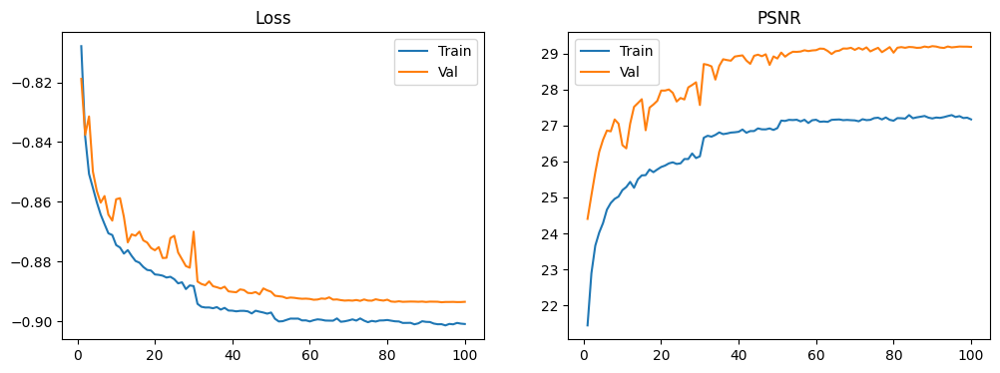

In [13]:
df = pd.DataFrame(history)
df.to_csv("/kaggle/working/train_log.csv", index=False)

plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1); plt.plot(df["epoch"], df["train_loss"], label="Train"); plt.plot(df["epoch"], df["val_loss"], label="Val"); plt.legend(); plt.title("Loss")
plt.subplot(1, 2, 2); plt.plot(df["epoch"], df["train_psnr"], label="Train"); plt.plot(df["epoch"], df["val_psnr"], label="Val"); plt.legend(); plt.title("PSNR")
plt.show()

Loaded Best Model.


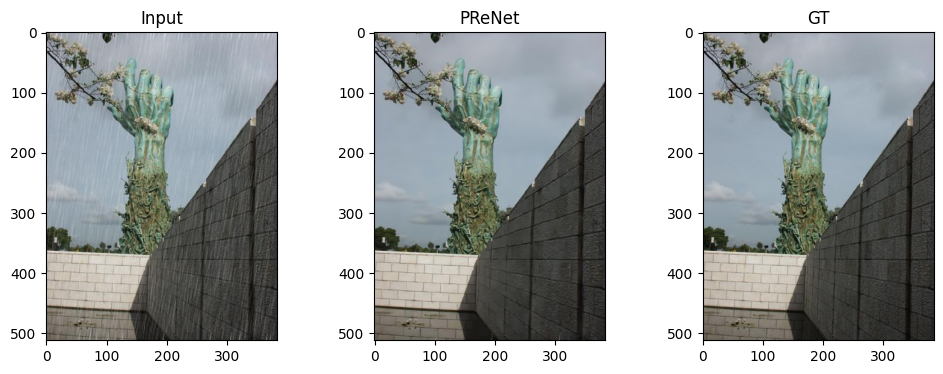

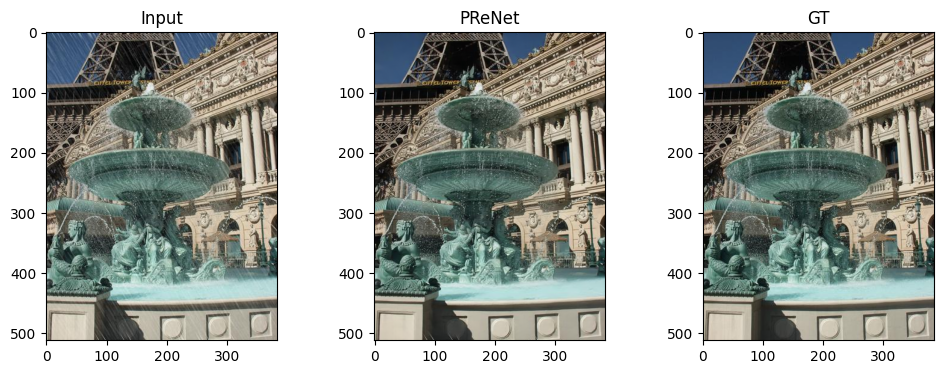

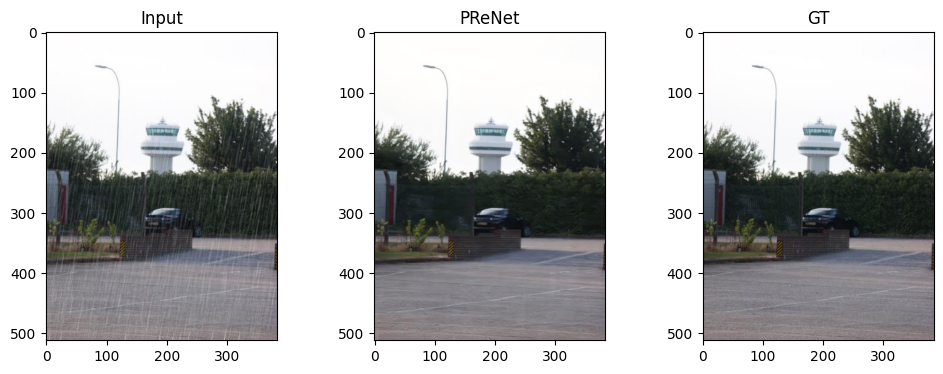

In [15]:
if BEST_PATH.exists():
    model.load_state_dict(torch.load(BEST_PATH)["model_state"])
    print("Loaded Best Model.")
model.eval()

samples = random.sample(list(test_loader), 3)
for i, (rainy, clean, _) in enumerate(samples):
    rainy, clean = rainy.to(device), clean.to(device)
    with torch.no_grad():
        pred, _ = model(rainy)
    
    r = rainy[0].cpu().permute(1,2,0).numpy()
    p = torch.clamp(pred[0], 0, 1).cpu().permute(1,2,0).numpy()
    c = clean[0].cpu().permute(1,2,0).numpy()
    
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(r); plt.title("Input")
    plt.subplot(1,3,2); plt.imshow(p); plt.title("PReNet")
    plt.subplot(1,3,3); plt.imshow(c); plt.title("GT")
    plt.show()

Loading weights from /kaggle/working/best_models/prenet_best.pth ...

=============== TESTING: Rain14000 Test ===============
   Input: input | GT: output
   📸 Found 1372 images.


Rain14000 Test:   0%|          | 0/1372 [00:00<?, ?it/s]

   Rain14000 Test Result:
      - Average PSNR: 29.3638 dB
      - Average SSIM: 0.8953
Visualizing 5 samples (Input - Output - Target):


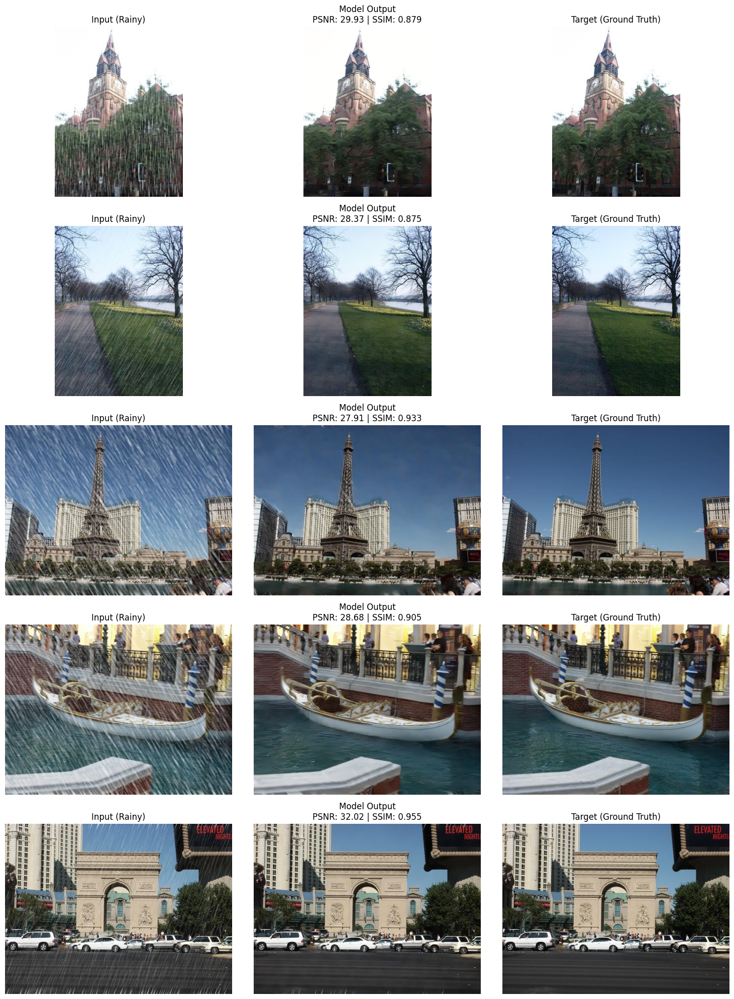


=============== TESTING: Test100 ===============
   Input: input | GT: target
   📸 Found 98 images.


Test100:   0%|          | 0/98 [00:00<?, ?it/s]

   Test100 Result:
      - Average PSNR: 22.6059 dB
      - Average SSIM: 0.8061
Visualizing 5 samples (Input - Output - Target):


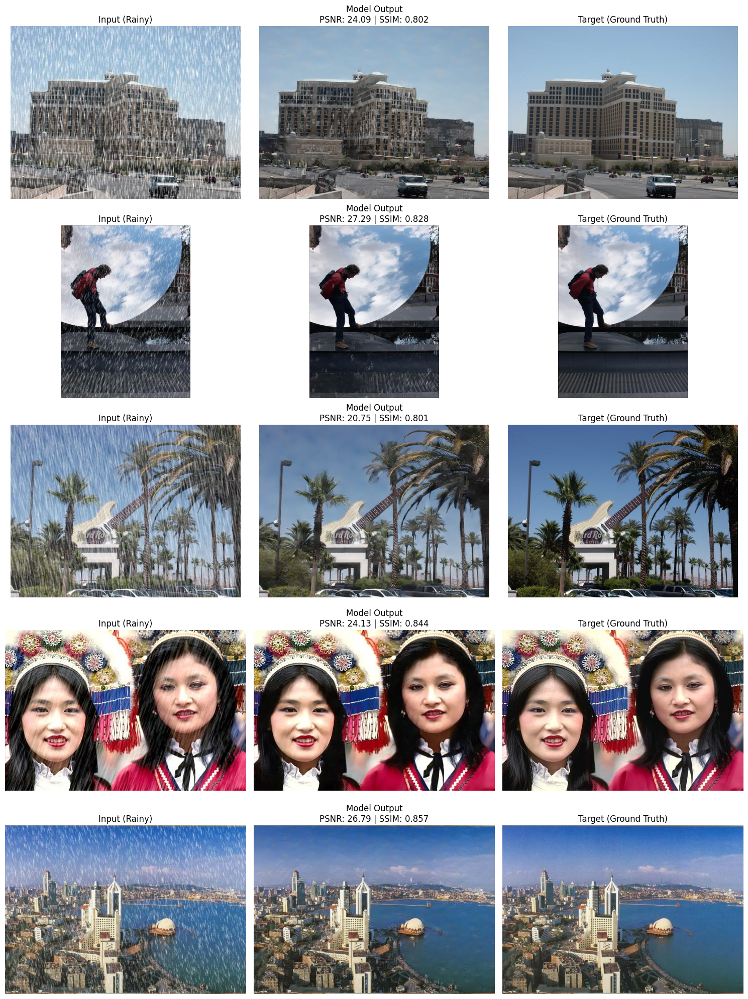


=============== TESTING: Test1200 ===============
   Input: input | GT: target
   📸 Found 1200 images.


Test1200:   0%|          | 0/1200 [00:00<?, ?it/s]

   Test1200 Result:
      - Average PSNR: 29.2071 dB
      - Average SSIM: 0.8773
Visualizing 5 samples (Input - Output - Target):


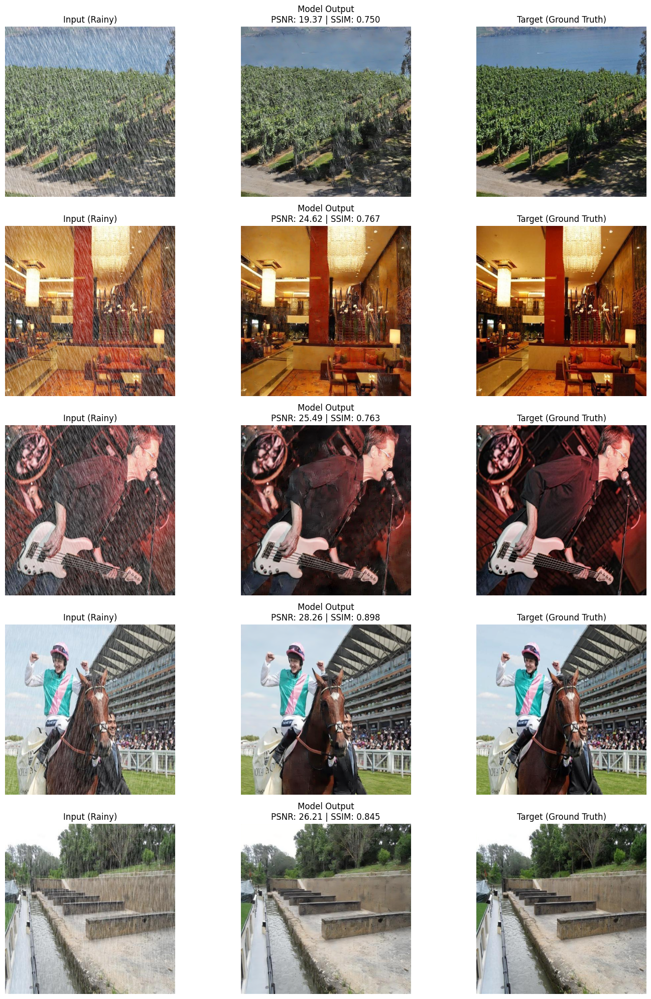


=============== TESTING: Test2800 ===============
   Input: input | GT: target
   📸 Found 2800 images.


Test2800:   0%|          | 0/2800 [00:00<?, ?it/s]

   Test2800 Result:
      - Average PSNR: 29.6541 dB
      - Average SSIM: 0.9046
Visualizing 5 samples (Input - Output - Target):


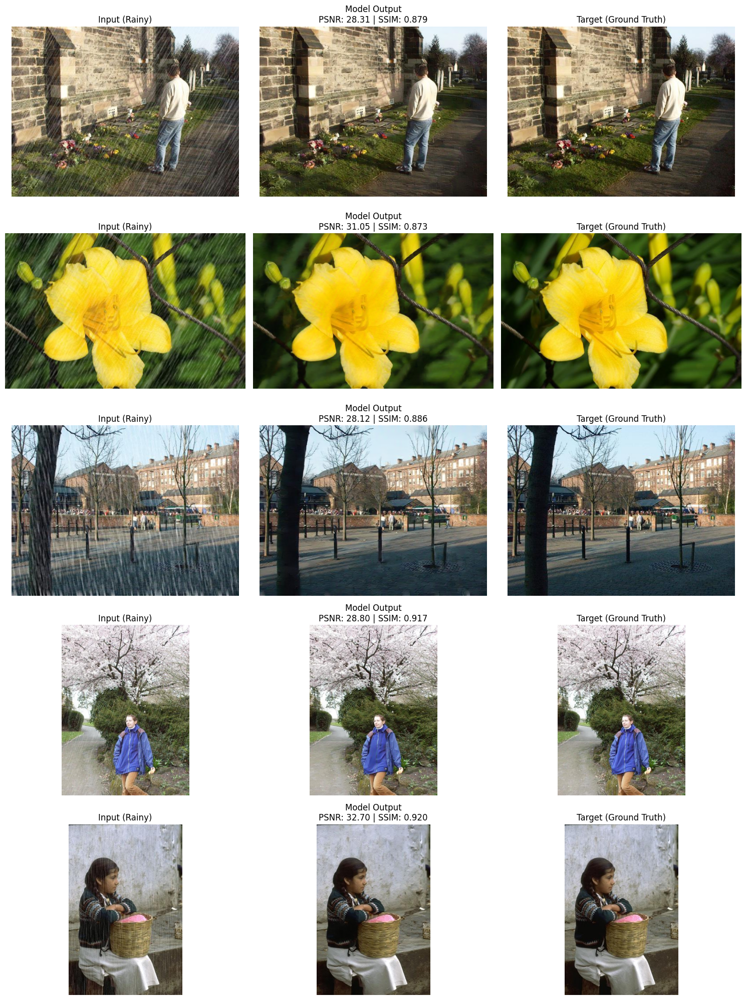


=============== TESTING: Heavy Rain ===============
   Input: rain | GT: norain
   📸 Found 200 images.


Heavy Rain:   0%|          | 0/200 [00:00<?, ?it/s]

   Heavy Rain Result:
      - Average PSNR: 24.0630 dB
      - Average SSIM: 0.8091
Visualizing 5 samples (Input - Output - Target):


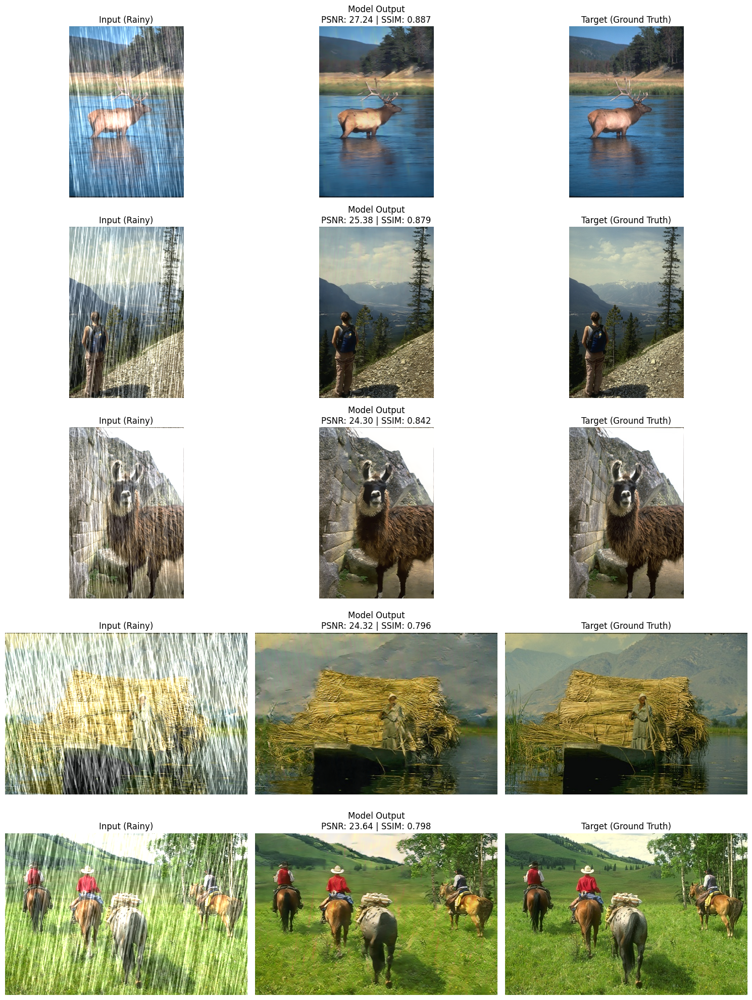


=============== TESTING: Light Rain ===============
   Input: rain | GT: norain
   📸 Found 200 images.


Light Rain:   0%|          | 0/200 [00:00<?, ?it/s]

   Light Rain Result:
      - Average PSNR: 29.4636 dB
      - Average SSIM: 0.9282
Visualizing 5 samples (Input - Output - Target):


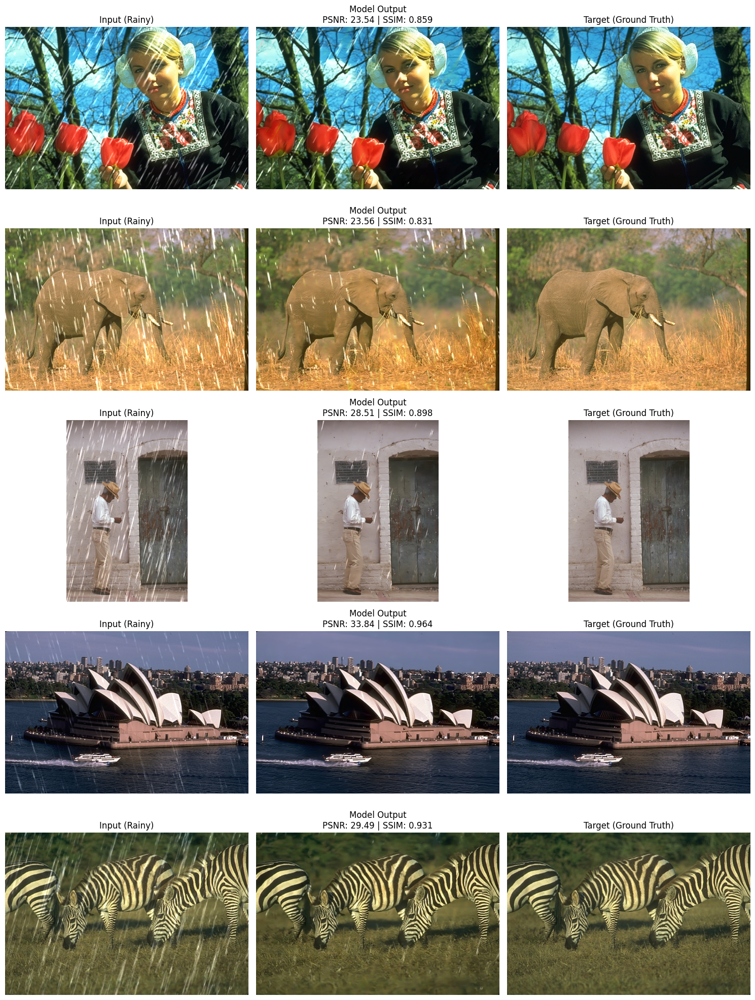

In [ ]:
# ======================================================
# 1. CẤU HÌNH ĐƯỜNG DẪN INPUT
# ======================================================
TEST_CONFIGS = {
    "Rain14000 Test": "/kaggle/input/rain14000/test/input",
    "Test100":        "/kaggle/input/rain-dataset/Test100/Test100/input",
    "Test1200":       "/kaggle/input/rain-dataset/Test1200/Test1200/input",
    "Test2800":       "/kaggle/input/rain-dataset/Test2800/Test2800/input",
    "Heavy Rain":     "/kaggle/input/rain-dataset/heavy-20251105T081926Z-1-001/heavy/test/rain",
    "Light Rain":     "/kaggle/input/rain-dataset/light-20251105T081926Z-1-001/light/test/rain"
}

# ======================================================
# 2. HÀM TỰ ĐỘNG TÌM FOLDER GROUND TRUTH
# ======================================================
def auto_find_gt_folder(input_path_str):
    in_path = Path(input_path_str)
    if not in_path.exists():
        return None
    
    parent = in_path.parent
    
    # Danh sách các tên folder GT phổ biến thường đi cặp với input/rain
    # Ưu tiên tìm theo cặp: rain -> norain, input -> output/target/label
    candidates = [
        "output",           # input -> output
        "target",           # input -> target
        "ground_truth",     # input -> ground_truth
        "norain",           # rain -> norain
        "clean",            # rain -> clean
        "label",            # data -> label
        "gt"                # chung chung
    ]
    
    # 1. Quét ngang hàng (cùng folder cha)
    for name in candidates:
        check_path = parent / name
        if check_path.exists():
            return check_path
            
    # 2. Fallback: Nếu không thấy ngang hàng, thử tìm đệ quy nhẹ (cho cấu trúc phức tạp)
    # Ví dụ: cha/rain/x.png vs cha/clean/x.png thì logic trên đã bắt được.
    # Nhưng nếu tên lạ quá thì chịu, trả về None.
    return None

# ======================================================
# 3. HÀM ĐÁNH GIÁ & VẼ ẢNH
# ======================================================
def evaluate_and_show(model, name, input_str, num_show=5):
    print(f"\n{'='*15} TESTING: {name} {'='*15}")
    
    # 1. Setup Paths
    in_dir = Path(input_str)
    gt_dir = auto_find_gt_folder(input_str)
    
    if not in_dir.exists():
        print(f"Input path not found: {in_dir}")
        return
        
    if gt_dir is None:
        print(f"Found Input: {in_dir}")
        print(f"Could not auto-detect Ground Truth folder in {in_dir.parent}")
        print(f"Available folders: {[p.name for p in in_dir.parent.iterdir() if p.is_dir()]}")
        return

    print(f"   Input: {in_dir.name} | GT: {gt_dir.name}")

    # 2. Load Dataset
    # augment=False vì test thì không lật ảnh
    ds = PairedDerainDataset(in_dir, gt_dir, patch_size=None, augment=False)
    
    if len(ds) == 0:
        print("   Dataset empty or filenames do not match.")
        return
        
    loader = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0)
    print(f"   📸 Found {len(ds)} images.")

    # 3. Run Inference
    psnr_list = []
    ssim_list = []
    saved_samples = []
    
    # Chọn index ngẫu nhiên để show
    show_indices = random.sample(range(len(ds)), min(num_show, len(ds)))
    
    model.eval()
    with torch.no_grad():
        for i, (rainy, clean, fname) in enumerate(tqdm(loader, desc=name, leave=False)):
            rainy = rainy.to(device)
            clean = clean.to(device)
            
            # Predict
            pred, _ = model(rainy)
            pred = torch.clamp(pred, 0, 1)
            clean = torch.clamp(clean, 0, 1)
            
            # Metrics
            ps = psnr_torch(pred, clean).item()
            ss = ssim_torch(pred, clean).item()
            psnr_list.append(ps)
            ssim_list.append(ss)
            
            # Save for visualization
            if i in show_indices:
                r_np = rainy[0].cpu().permute(1,2,0).numpy()
                p_np = pred[0].cpu().permute(1,2,0).numpy()
                c_np = clean[0].cpu().permute(1,2,0).numpy()
                saved_samples.append((r_np, p_np, c_np, ps, ss))

    # 4. Print Results
    avg_psnr = np.mean(psnr_list)
    avg_ssim = np.mean(ssim_list)
    print(f"   {name} Result:")
    print(f"      - Average PSNR: {avg_psnr:.4f} dB")
    print(f"      - Average SSIM: {avg_ssim:.4f}")
    
    # 5. Visualize
    if len(saved_samples) > 0:
        print(f"Visualizing {len(saved_samples)} samples (Input - Output - Target):")
        
        # Tạo khung hình: số dòng = số ảnh mẫu, 3 cột
        fig, axes = plt.subplots(len(saved_samples), 3, figsize=(15, 4 * len(saved_samples)))
        if len(saved_samples) == 1: axes = [axes] # Fix lỗi dimension nếu chỉ có 1 ảnh
        
        for idx, (r, p, c, ps, ss) in enumerate(saved_samples):
            ax_row = axes[idx] if len(saved_samples) > 1 else axes
            
            # Input
            ax_row[0].imshow(r)
            ax_row[0].set_title("Input (Rainy)")
            ax_row[0].axis("off")
            
            # Output
            ax_row[1].imshow(p)
            ax_row[1].set_title(f"Model Output\nPSNR: {ps:.2f} | SSIM: {ss:.3f}")
            ax_row[1].axis("off")
            
            # Target
            ax_row[2].imshow(c)
            ax_row[2].set_title("Target (Ground Truth)")
            ax_row[2].axis("off")
            
        plt.tight_layout()
        plt.show()

# ======================================================
# 4. MAIN RUN
# ======================================================

# Load Model tốt nhất nếu có
if BEST_PATH.exists():
    print(f"Loading weights from {BEST_PATH} ...")
    model.load_state_dict(torch.load(BEST_PATH)["model_state"])
else:
    print("Warning: Best checkpoint not found. Using current model weights.")

model.eval()

# Chạy vòng lặp qua từng tập trong config
for ds_name, ds_path in TEST_CONFIGS.items():
    evaluate_and_show(model, ds_name, ds_path, num_show=5)

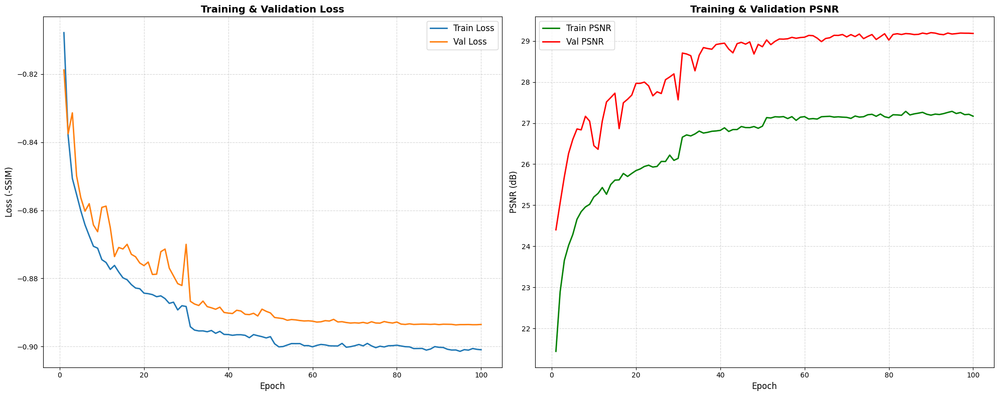

In [ ]:
# Cell vẽ biểu đồ (Updated)
import matplotlib.pyplot as plt
import pandas as pd

if 'history' in globals():
    df = pd.DataFrame(history)
else:
    try:
        df = pd.read_csv("/kaggle/working/train_log.csv")
    except:
        print("Chưa có dữ liệu để vẽ!")

plt.figure(figsize=(20, 8)) 

# 1. Biểu đồ Loss
plt.subplot(1, 2, 1)
plt.plot(df["epoch"], df["train_loss"], label="Train Loss", linewidth=2)
plt.plot(df["epoch"], df["val_loss"], label="Val Loss", linewidth=2)
plt.legend(fontsize=12)
plt.title("Training & Validation Loss", fontsize=14, fontweight='bold')
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss (-SSIM)", fontsize=12)
plt.grid(True, which='both', linestyle='--', alpha=0.5) # Thêm lưới

# 2. Biểu đồ PSNR
plt.subplot(1, 2, 2)
plt.plot(df["epoch"], df["train_psnr"], label="Train PSNR", color='green', linewidth=2)
plt.plot(df["epoch"], df["val_psnr"], label="Val PSNR", color='red', linewidth=2)
plt.legend(fontsize=12)
plt.title("Training & Validation PSNR", fontsize=14, fontweight='bold')
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("PSNR (dB)", fontsize=12)
plt.grid(True, which='both', linestyle='--', alpha=0.5) # Thêm lưới

plt.tight_layout()
plt.show()

In [21]:
# Đếm số lượng tham số có thể train được
total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"🔢 Tổng số tham số của PReNet: {total_params:,}")

🔢 Tổng số tham số của PReNet: 168,963
